<a href="https://colab.research.google.com/github/fcolombo7/AN2DL-2020/blob/main/Intro.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [3]:
import os
import tensorflow as tf
import numpy as np
import pandas as pd

SEED = 1234
tf.random.set_seed(SEED)  

img_h, img_w = (512, 512)
bs = 64

# Get current working directory
cwd = os.getcwd()

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
!unzip '/content/drive/My Drive/ANN_project/artificial-neural-networks-and-deep-learning-2020.zip'

Output streaming troncato alle ultime 5000 righe.
  inflating: MaskDataset/training/10892.jpg  
  inflating: MaskDataset/training/10894.jpg  
  inflating: MaskDataset/training/10899.jpg  
  inflating: MaskDataset/training/10901.jpg  
  inflating: MaskDataset/training/10902.jpg  
  inflating: MaskDataset/training/10905.jpg  
  inflating: MaskDataset/training/10906.jpg  
  inflating: MaskDataset/training/10907.jpg  
  inflating: MaskDataset/training/10908.jpg  
  inflating: MaskDataset/training/10911.jpg  
  inflating: MaskDataset/training/10913.jpg  
  inflating: MaskDataset/training/10915.jpg  
  inflating: MaskDataset/training/10916.jpg  
  inflating: MaskDataset/training/10917.jpg  
  inflating: MaskDataset/training/10919.jpg  
  inflating: MaskDataset/training/10920.jpg  
  inflating: MaskDataset/training/10921.jpg  
  inflating: MaskDataset/training/10922.jpg  
  inflating: MaskDataset/training/10923.jpg  
  inflating: MaskDataset/training/10925.jpg  
  inflating: MaskDataset/train

In [6]:
!ls

drive  MaskDataset  sample_data


In [7]:
!ls MaskDataset/

test  train_gt.json  training


In [10]:
'''import pathlib
data_dir = pathlib.Path(cwd)
roses = list(data_dir.glob('MaskDataset/training/*'))'''

In [12]:
'''import PIL

for image in roses:
  PIL.Image.open(str(image)).size'''

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(411, 612)

(612, 405)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 445)

(612, 408)

(612, 408)

(612, 408)

(612, 433)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 562)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 488)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(472, 612)

(612, 421)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 413)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 400)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 419)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 475)

(612, 473)

(612, 408)

(612, 408)

(612, 446)

(612, 612)

(612, 408)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 475)

(612, 443)

(612, 408)

(612, 426)

(612, 407)

(612, 408)

(612, 408)

(612, 459)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 392)

(408, 612)

(612, 408)

(612, 427)

(612, 382)

(612, 408)

(612, 408)

(612, 423)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 414)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 436)

(612, 408)

(612, 467)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 445)

(612, 407)

(612, 408)

(612, 408)

(459, 612)

(433, 612)

(408, 612)

(612, 408)

(612, 318)

(612, 408)

(612, 408)

(612, 455)

(612, 408)

(612, 408)

(612, 428)

(612, 408)

(612, 408)

(612, 490)

(612, 454)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 417)

(612, 408)

(612, 409)

(612, 413)

(612, 408)

(612, 408)

(612, 344)

(612, 407)

(612, 408)

(612, 408)

(612, 407)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 413)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 386)

(612, 408)

(612, 408)

(612, 407)

(612, 447)

(612, 408)

(612, 424)

(612, 459)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 441)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 449)

(612, 408)

(612, 408)

(612, 407)

(424, 612)

(612, 408)

(612, 408)

(612, 363)

(408, 612)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 423)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 361)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 445)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(409, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 430)

(612, 459)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 420)

(612, 409)

(612, 433)

(612, 408)

(459, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(385, 612)

(612, 408)

(612, 541)

(612, 408)

(399, 612)

(459, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(407, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 418)

(612, 408)

(612, 407)

(612, 389)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 498)

(413, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 410)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 410)

(612, 406)

(612, 408)

(411, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 419)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 323)

(612, 408)

(612, 407)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 418)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(407, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 445)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 325)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 459)

(612, 409)

(612, 408)

(612, 353)

(612, 408)

(612, 376)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(612, 408)

(612, 323)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 409)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 451)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 409)

(612, 408)

(612, 437)

(612, 408)

(612, 422)

(612, 408)

(458, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 406)

(408, 612)

(612, 408)

(561, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 383)

(612, 408)

(408, 612)

(612, 438)

(612, 408)

(612, 406)

(612, 408)

(612, 414)

(612, 408)

(612, 408)

(612, 432)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(608, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(602, 612)

(612, 408)

(612, 408)

(495, 612)

(612, 383)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(537, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 512)

(612, 408)

(612, 408)

(612, 404)

(612, 408)

(612, 408)

(612, 477)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 407)

(612, 612)

(612, 408)

(420, 612)

(612, 408)

(407, 612)

(612, 409)

(612, 408)

(612, 459)

(612, 408)

(612, 413)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 442)

(612, 408)

(612, 408)

(421, 612)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(380, 612)

(612, 438)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 376)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 459)

(408, 612)

(612, 395)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 400)

(612, 409)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 396)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(408, 612)

(612, 373)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 462)

(612, 387)

(612, 464)

(612, 345)

(612, 408)

(408, 612)

(612, 408)

(612, 421)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(489, 612)

(612, 408)

(612, 400)

(612, 408)

(408, 612)

(612, 408)

(612, 394)

(612, 408)

(612, 408)

(612, 408)

(442, 612)

(612, 408)

(612, 395)

(612, 408)

(408, 612)

(612, 408)

(612, 467)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 385)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 499)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 435)

(612, 408)

(612, 365)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(444, 612)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 435)

(612, 408)

(490, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 552)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 424)

(612, 407)

(612, 416)

(612, 401)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 410)

(612, 432)

(612, 408)

(408, 612)

(446, 612)

(612, 408)

(612, 392)

(612, 408)

(612, 315)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 382)

(612, 408)

(612, 408)

(612, 408)

(612, 439)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(470, 612)

(612, 408)

(612, 408)

(612, 408)

(416, 612)

(612, 408)

(612, 459)

(471, 612)

(612, 408)

(612, 437)

(612, 612)

(612, 408)

(612, 459)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 452)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 591)

(612, 408)

(612, 403)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 490)

(612, 408)

(612, 408)

(612, 408)

(612, 434)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(429, 612)

(612, 362)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 438)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 421)

(612, 341)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 451)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 431)

(612, 398)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 490)

(612, 407)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 447)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(406, 612)

(612, 408)

(612, 408)

(612, 528)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 431)

(612, 408)

(612, 575)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(600, 612)

(612, 408)

(612, 418)

(612, 408)

(612, 368)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 420)

(408, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 423)

(612, 408)

(612, 408)

(612, 449)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 382)

(612, 408)

(408, 612)

(612, 408)

(612, 473)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 379)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 367)

(612, 398)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(459, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 469)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 413)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 471)

(407, 612)

(612, 459)

(396, 612)

(612, 408)

(612, 394)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 591)

(612, 408)

(612, 450)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 466)

(612, 408)

(508, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 460)

(612, 408)

(612, 408)

(612, 408)

(612, 402)

(612, 437)

(612, 408)

(612, 419)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 463)

(612, 408)

(612, 481)

(510, 612)

(612, 408)

(612, 409)

(612, 400)

(612, 459)

(612, 408)

(408, 612)

(612, 408)

(612, 384)

(612, 369)

(612, 393)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(456, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 457)

(612, 409)

(612, 408)

(612, 416)

(612, 444)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 396)

(612, 400)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 398)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 445)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 447)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 432)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 459)

(612, 376)

(612, 453)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 554)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 427)

(612, 408)

(612, 408)

(612, 600)

(612, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 256)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 444)

(612, 408)

(612, 394)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 435)

(612, 408)

(612, 408)

(612, 612)

(408, 612)

(612, 408)

(612, 426)

(612, 408)

(612, 414)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 384)

(612, 408)

(612, 411)

(612, 433)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 394)

(612, 408)

(612, 530)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(406, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 505)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 392)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 435)

(612, 408)

(612, 408)

(612, 397)

(612, 408)

(612, 369)

(612, 521)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 445)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 381)

(612, 408)

(480, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 490)

(612, 408)

(612, 457)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(478, 612)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 418)

(612, 408)

(612, 499)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(564, 612)

(612, 405)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(459, 612)

(408, 612)

(612, 396)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 479)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 458)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 421)

(612, 408)

(612, 407)

(612, 344)

(612, 408)

(612, 344)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 344)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 403)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 494)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(542, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 386)

(612, 408)

(612, 408)

(612, 420)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 332)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 409)

(612, 398)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 371)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 395)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 428)

(612, 456)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 602)

(612, 408)

(612, 408)

(612, 459)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 447)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(459, 612)

(612, 408)

(612, 408)

(612, 371)

(408, 612)

(408, 612)

(612, 408)

(612, 506)

(612, 408)

(459, 612)

(593, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 370)

(612, 408)

(612, 408)

(612, 408)

(612, 394)

(612, 408)

(612, 396)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 392)

(612, 408)

(612, 408)

(612, 408)

(415, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 472)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 414)

(444, 612)

(612, 408)

(612, 344)

(612, 408)

(612, 422)

(612, 396)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 417)

(408, 612)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 473)

(612, 408)

(612, 393)

(612, 428)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 432)

(612, 415)

(612, 408)

(612, 397)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 395)

(612, 408)

(612, 418)

(612, 408)

(612, 408)

(612, 416)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 336)

(486, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 399)

(612, 408)

(612, 408)

(612, 459)

(612, 423)

(612, 408)

(612, 408)

(612, 408)

(612, 330)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 415)

(612, 408)

(612, 383)

(612, 408)

(612, 408)

(612, 408)

(612, 465)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 451)

(612, 493)

(612, 408)

(612, 408)

(612, 408)

(407, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 344)

(408, 612)

(612, 408)

(408, 612)

(612, 407)

(612, 408)

(612, 408)

(612, 459)

(612, 437)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 394)

(612, 408)

(612, 408)

(612, 408)

(612, 383)

(612, 408)

(612, 408)

(612, 407)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 530)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 389)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 514)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(408, 612)

(612, 360)

(612, 604)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 376)

(612, 408)

(612, 492)

(612, 409)

(612, 408)

(612, 408)

(536, 612)

(612, 408)

(612, 408)

(459, 612)

(612, 408)

(407, 612)

(612, 407)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 408)

(612, 339)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 566)

(612, 396)

(612, 408)

(612, 456)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 417)

(612, 408)

(434, 612)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 428)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 414)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 417)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 372)

(612, 527)

(612, 408)

(612, 408)

(612, 408)

(612, 399)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 323)

(612, 408)

(612, 408)

(612, 409)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 420)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 391)

(612, 408)

(612, 435)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 370)

(612, 408)

(612, 440)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 368)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(459, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 478)

(612, 408)

(408, 612)

(612, 408)

(612, 428)

(612, 408)

(612, 418)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 379)

(408, 612)

(407, 612)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 400)

(408, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 533)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 399)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 419)

(612, 408)

(612, 408)

(612, 422)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 528)

(612, 408)

(612, 422)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 393)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 386)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 459)

(612, 409)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 392)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(423, 612)

(612, 408)

(612, 396)

(612, 408)

(612, 408)

(612, 412)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 381)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 460)

(612, 408)

(459, 612)

(612, 408)

(408, 612)

(612, 394)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 419)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 329)

(612, 408)

(612, 405)

(612, 385)

(612, 408)

(612, 408)

(612, 408)

(345, 612)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 396)

(612, 408)

(612, 407)

(612, 517)

(612, 409)

(612, 408)

(456, 612)

(612, 423)

(612, 408)

(612, 561)

(612, 408)

(433, 612)

(612, 408)

(612, 408)

(612, 430)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 425)

(612, 424)

(612, 408)

(612, 369)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 448)

(612, 392)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 395)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(612, 381)

(408, 612)

(612, 408)

(431, 612)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 433)

(612, 408)

(612, 408)

(490, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 416)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(516, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 456)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 370)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 386)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 453)

(612, 612)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(570, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(459, 612)

(612, 408)

(612, 408)

(612, 408)

(423, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(555, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 392)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 510)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 453)

(612, 408)

(612, 408)

(408, 612)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 383)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 397)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 524)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 510)

(612, 408)

(612, 449)

(612, 419)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(408, 612)

(612, 445)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 420)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 430)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 382)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 344)

(612, 488)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 423)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 411)

(612, 408)

(405, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 382)

(612, 394)

(612, 612)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 366)

(612, 460)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 438)

(612, 408)

(612, 596)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(410, 612)

(612, 408)

(612, 391)

(612, 408)

(612, 441)

(459, 612)

(408, 612)

(612, 419)

(612, 408)

(612, 459)

(612, 443)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(408, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 398)

(612, 521)

(612, 408)

(612, 408)

(612, 438)

(612, 408)

(612, 612)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 433)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 401)

(612, 408)

(612, 408)

(612, 410)

(612, 408)

(612, 408)

(612, 419)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 412)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 443)

(612, 408)

(401, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 469)

(612, 409)

(612, 408)

(502, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(511, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 407)

(612, 408)

(612, 412)

(612, 408)

(612, 408)

(612, 408)

(612, 456)

(612, 408)

(612, 422)

(612, 409)

(612, 413)

(612, 459)

(612, 408)

(612, 408)

(612, 460)

(612, 438)

(612, 408)

(408, 612)

(612, 408)

(612, 452)

(612, 404)

(612, 475)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 568)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 461)

(612, 408)

(612, 483)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 428)

(612, 460)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 455)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 365)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 343)

(500, 612)

(612, 408)

(612, 408)

(612, 433)

(408, 612)

(612, 408)

(612, 488)

(612, 408)

(612, 460)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 422)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 395)

(612, 495)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(408, 612)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 459)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 435)

(612, 410)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(426, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 401)

(497, 612)

(612, 344)

(612, 408)

(612, 408)

(612, 344)

(612, 384)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 441)

(612, 433)

(408, 612)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 375)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 465)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(469, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 398)

(612, 408)

(612, 417)

(612, 402)

(612, 408)

(612, 409)

(458, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 423)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 421)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 436)

(612, 408)

(612, 408)

(612, 408)

(612, 372)

(612, 408)

(612, 408)

(612, 408)

(612, 427)

(612, 407)

(612, 425)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 612)

(612, 409)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 430)

(612, 408)

(612, 396)

(612, 409)

(435, 612)

(612, 437)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 458)

(612, 448)

(612, 411)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 421)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 392)

(612, 408)

(612, 371)

(612, 408)

(612, 408)

(612, 408)

(612, 464)

(612, 435)

(612, 408)

(612, 408)

(612, 441)

(612, 408)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(612, 372)

(612, 409)

(612, 408)

(612, 407)

(612, 408)

(464, 612)

(612, 433)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 405)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 443)

(612, 408)

(612, 438)

(612, 438)

(612, 408)

(612, 408)

(612, 427)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(399, 612)

(612, 408)

(612, 397)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 370)

(612, 408)

(612, 408)

(612, 408)

(460, 612)

(612, 459)

(612, 408)

(612, 408)

(612, 409)

(612, 406)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 389)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 349)

(612, 408)

(612, 408)

(612, 408)

(612, 323)

(612, 408)

(612, 408)

(612, 596)

(612, 492)

(612, 408)

(612, 408)

(612, 408)

(612, 490)

(612, 408)

(612, 408)

(612, 408)

(612, 423)

(612, 408)

(612, 408)

(612, 408)

(488, 612)

(417, 612)

(612, 429)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 385)

(408, 612)

(612, 612)

(612, 408)

(612, 366)

(612, 436)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(432, 612)

(612, 408)

(612, 557)

(612, 425)

(612, 408)

(612, 424)

(612, 408)

(612, 447)

(612, 408)

(612, 408)

(612, 408)

(612, 438)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 379)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 502)

(612, 408)

(612, 408)

(612, 408)

(612, 460)

(612, 518)

(612, 408)

(612, 408)

(612, 433)

(612, 408)

(612, 352)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 432)

(612, 408)

(612, 334)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 439)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 410)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 395)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(459, 612)

(612, 408)

(612, 391)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 383)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(612, 408)

(612, 428)

(612, 408)

(612, 408)

(612, 459)

(612, 514)

(612, 408)

(612, 438)

(612, 326)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 452)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 518)

(612, 408)

(408, 612)

(612, 408)

(612, 369)

(408, 612)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 394)

(612, 408)

(612, 408)

(612, 409)

(612, 360)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 546)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 323)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 433)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 450)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 456)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 515)

(612, 408)

(612, 408)

(612, 458)

(612, 408)

(612, 345)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 412)

(612, 408)

(612, 612)

(612, 388)

(612, 418)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 412)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(492, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 475)

(612, 408)

(612, 407)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 408)

(612, 408)

(612, 411)

(612, 401)

(612, 408)

(612, 405)

(612, 408)

(612, 408)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(612, 408)

(571, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 375)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 441)

(612, 408)

(612, 407)

(412, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 433)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 323)

(612, 408)

(612, 364)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 409)

(612, 408)

(408, 612)

(612, 408)

(612, 434)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 395)

(612, 459)

(612, 323)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 429)

(612, 408)

(612, 408)

(612, 469)

(612, 408)

(427, 612)

(437, 612)

(612, 431)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 471)

(612, 408)

(612, 420)

(612, 408)

(612, 411)

(408, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(394, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 471)

(612, 430)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 402)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 402)

(612, 408)

(612, 408)

(612, 408)

(612, 397)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 528)

(612, 408)

(612, 408)

(612, 408)

(612, 393)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 440)

(612, 399)

(612, 408)

(612, 408)

(612, 408)

(612, 385)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 459)

(612, 612)

(612, 445)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 406)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 400)

(612, 408)

(612, 408)

(612, 408)

(612, 447)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 330)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 481)

(612, 408)

(612, 397)

(612, 408)

(612, 408)

(381, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 437)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(409, 612)

(612, 407)

(612, 392)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 428)

(612, 408)

(408, 612)

(612, 476)

(408, 612)

(612, 457)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(465, 612)

(612, 455)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(488, 612)

(612, 408)

(449, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 459)

(612, 422)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 409)

(408, 612)

(612, 408)

(612, 481)

(612, 408)

(612, 408)

(612, 408)

(612, 427)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 438)

(612, 436)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(483, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 409)

(612, 408)

(408, 612)

(612, 408)

(356, 612)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 411)

(612, 408)

(612, 454)

(612, 407)

(612, 411)

(612, 408)

(612, 329)

(408, 612)

(612, 454)

(612, 408)

(612, 408)

(612, 408)

(612, 437)

(612, 408)

(612, 406)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 377)

(612, 408)

(612, 408)

(612, 338)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(408, 612)

(612, 408)

(612, 408)

(612, 405)

(408, 612)

(612, 426)

(612, 408)

(408, 612)

(612, 399)

(612, 323)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 410)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 429)

(612, 408)

(612, 612)

(612, 402)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 374)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 404)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(408, 612)

(612, 408)

(456, 612)

(612, 434)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 612)

(612, 612)

(612, 382)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(490, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 496)

(612, 408)

(612, 408)

(612, 408)

(612, 423)

(612, 408)

(612, 470)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(612, 407)

(612, 490)

(612, 408)

(612, 408)

(612, 459)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 443)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 398)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(457, 612)

(612, 408)

(612, 408)

(612, 392)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 555)

(612, 456)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 409)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 430)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(401, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 388)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 383)

(612, 407)

(612, 348)

(612, 408)

(612, 344)

(612, 408)

(408, 612)

(612, 459)

(612, 408)

(612, 389)

(612, 408)

(612, 408)

(612, 408)

(612, 418)

(612, 408)

(408, 612)

(612, 407)

(612, 408)

(612, 408)

(612, 407)

(612, 403)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 442)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 426)

(612, 408)

(612, 409)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 458)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 384)

(612, 407)

(612, 408)

(612, 408)

(612, 400)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 422)

(612, 408)

(612, 424)

(405, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 412)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 432)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 556)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 422)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 459)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 465)

(612, 460)

(612, 408)

(612, 408)

(612, 390)

(612, 414)

(408, 612)

(612, 408)

(612, 435)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 384)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 410)

(612, 408)

(612, 398)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 400)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 418)

(612, 408)

(612, 408)

(612, 408)

(612, 497)

(612, 414)

(612, 407)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(415, 612)

(612, 408)

(612, 410)

(612, 441)

(612, 408)

(612, 408)

(612, 408)

(612, 365)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 408)

(612, 408)

(612, 398)

(612, 408)

(612, 408)

(612, 364)

(612, 408)

(470, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 456)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 444)

(612, 408)

(612, 408)

(612, 408)

(409, 612)

(612, 442)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 422)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 404)

(612, 408)

(612, 402)

(612, 408)

(612, 443)

(612, 408)

(612, 508)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 419)

(408, 612)

(408, 612)

(612, 407)

(612, 492)

(612, 408)

(612, 408)

(612, 408)

(612, 389)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 398)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 452)

(612, 408)

(612, 408)

(612, 554)

(612, 413)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 414)

(612, 262)

(612, 408)

(612, 459)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 425)

(612, 408)

(419, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 447)

(612, 528)

(612, 408)

(612, 408)

(612, 459)

(408, 612)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 439)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 418)

(612, 408)

(612, 408)

(612, 408)

(404, 612)

(612, 439)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(612, 391)

(612, 408)

(612, 408)

(612, 442)

(612, 408)

(612, 408)

(612, 408)

(406, 612)

(612, 408)

(408, 612)

(612, 406)

(612, 403)

(612, 404)

(612, 408)

(612, 419)

(612, 408)

(612, 402)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(445, 612)

(612, 408)

(612, 408)

(612, 392)

(612, 527)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 395)

(612, 436)

(612, 408)

(612, 404)

(612, 408)

(612, 413)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 404)

(612, 408)

(612, 408)

(612, 408)

(612, 424)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 386)

(612, 408)

(612, 462)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 443)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 460)

(612, 408)

(612, 430)

(612, 490)

(612, 408)

(612, 408)

(612, 408)

(612, 418)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 414)

(612, 408)

(612, 408)

(612, 408)

(612, 434)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 405)

(612, 409)

(612, 387)

(612, 408)

(612, 408)

(612, 341)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 407)

(612, 408)

(612, 391)

(612, 408)

(612, 453)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 405)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(461, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 414)

(612, 408)

(612, 431)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 510)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 463)

(612, 408)

(612, 405)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 405)

(612, 408)

(612, 434)

(612, 408)

(612, 362)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 405)

(424, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 402)

(612, 383)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 459)

(612, 459)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 409)

(408, 612)

(612, 408)

(612, 408)

(612, 470)

(612, 425)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 404)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 388)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 467)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 417)

(612, 408)

(612, 408)

(612, 379)

(612, 408)

(612, 407)

(612, 408)

(612, 500)

(612, 408)

(612, 408)

(612, 409)

(406, 612)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 427)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 441)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 344)

(612, 408)

(612, 408)

(612, 407)

(460, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 398)

(612, 408)

(612, 458)

(451, 612)

(612, 408)

(612, 408)

(612, 406)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 416)

(612, 408)

(612, 408)

(612, 459)

(612, 408)

(612, 459)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 459)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 459)

(612, 533)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(407, 612)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 387)

(612, 408)

(612, 408)

(612, 462)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(480, 612)

(612, 460)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 417)

(612, 388)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 562)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 437)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 403)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 390)

(612, 344)

(612, 407)

(612, 408)

(612, 408)

(612, 410)

(612, 408)

(612, 419)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(408, 612)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 457)

(612, 409)

(612, 408)

(612, 408)

(612, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 503)

(612, 408)

(427, 612)

(612, 459)

(612, 408)

(612, 408)

(612, 420)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 365)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(612, 408)

(612, 455)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 349)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(453, 612)

(612, 437)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 412)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(459, 612)

(612, 408)

(612, 425)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(463, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 409)

(612, 408)

(612, 407)

(612, 408)

(612, 395)

(407, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 378)

(408, 612)

(612, 435)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 431)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(408, 612)

(409, 612)

(437, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 413)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 344)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 467)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 357)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(409, 612)

(612, 454)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 406)

(612, 408)

(612, 414)

(612, 408)

(612, 408)

(408, 612)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 439)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(383, 612)

(612, 408)

(408, 612)

(612, 358)

(612, 408)

(612, 408)

(612, 408)

(612, 354)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 441)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 407)

(612, 408)

(612, 409)

(612, 411)

(612, 408)

(612, 408)

(612, 408)

(612, 442)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

(612, 408)

In [19]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

apply_data_augmentation = True

# Create training ImageDataGenerator object
if apply_data_augmentation:
    train_data_gen = ImageDataGenerator(rotation_range=10,
                                        width_shift_range=10,
                                        height_shift_range=10,
                                        zoom_range=0.3,
                                        horizontal_flip=True,
                                        brightness_range = [0.7, 1.35],
                                        channel_shift_range=0.2,
                                        fill_mode='nearest',
                                        rescale=1./255,
                                        validation_split=0.2)
else:
    train_data_gen = ImageDataGenerator(rescale=1./255)

# Create validation and test ImageDataGenerator objects
# valid_data_gen = ImageDataGenerator(rescale=1./255)
# test_data_gen = ImageDataGenerator(rescale=1./255)

In [20]:
import json

dataset_dir = os.path.join(cwd, "MaskDataset")
training_dir = os.path.join(dataset_dir, "training")
with open(os.path.join(dataset_dir,"train_gt.json")) as f:
  dic = json.load(f)
  dataframe = pd.DataFrame(dic.items())
  dataframe.rename(columns = {0:'filename', 1:'class'}, inplace = True)
  dataframe["class"] = dataframe["class"].astype('string')
  train_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=bs,
                                               target_size=(img_h, img_w),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED,
                                               subset = 'training')
  
  validation_gen = train_data_gen.flow_from_dataframe(dataframe,
                                               training_dir,
                                               batch_size=bs,
                                               target_size=(img_h, img_w),
                                               class_mode='categorical',
                                               shuffle=True,
                                               seed=SEED,
                                               subset = 'validation')

Found 4492 validated image filenames belonging to 3 classes.
Found 1122 validated image filenames belonging to 3 classes.


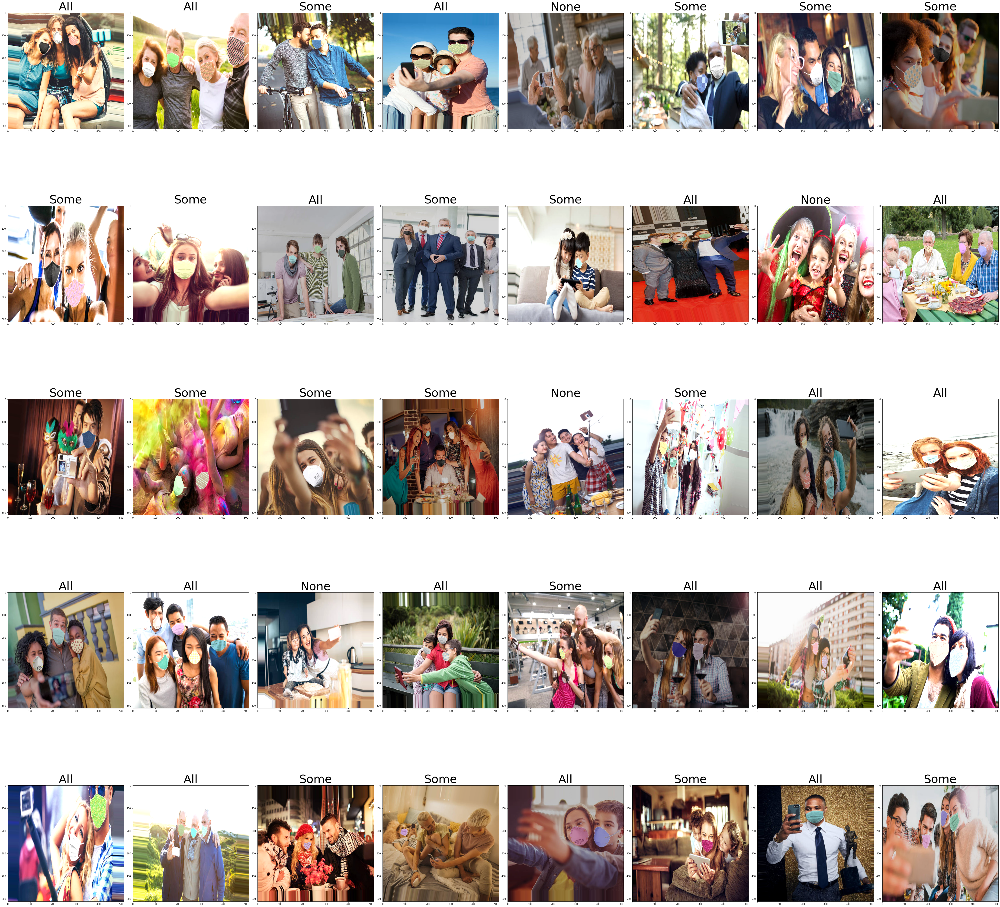

In [21]:
import matplotlib.pyplot as plt
%matplotlib inline

x_batch, y_batch = next(train_gen)

classes = np.array(["None", "All", "Some"])

axes=[]
fig=plt.figure(figsize=(60, 60))

for i in range(5*8):
    img = x_batch[i]
    axes.append( fig.add_subplot(5, 8, i+1) )
    subplot_title=(classes[y_batch[i].nonzero()][0])
    axes[-1].set_title(subplot_title, fontsize=50)  
    plt.imshow(img)
fig.tight_layout()    
plt.show();